# Classifying Breast Tumors

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report, roc_curve, roc_auc_score
from sklearn.linear_model import LogisticRegression

In [ ]:
# dataset directory https://archive.ics.uci.edu/dataset/17/breast+cancer+wisconsin+diagnostic

breast_src = '/content/wdbc.data'

In [ ]:
# upload as dataframe

breast_df = pd.read_csv(breast_src, header=None)
display(breast_df)

,0,1,2,3,4,5,6,7,8,9,...,22,23,24,25,26,27,28,29,30,31
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,...,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,...,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,...,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,...,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,...,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,926424,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,...,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,926682,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,...,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,926954,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,...,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,927241,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,...,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


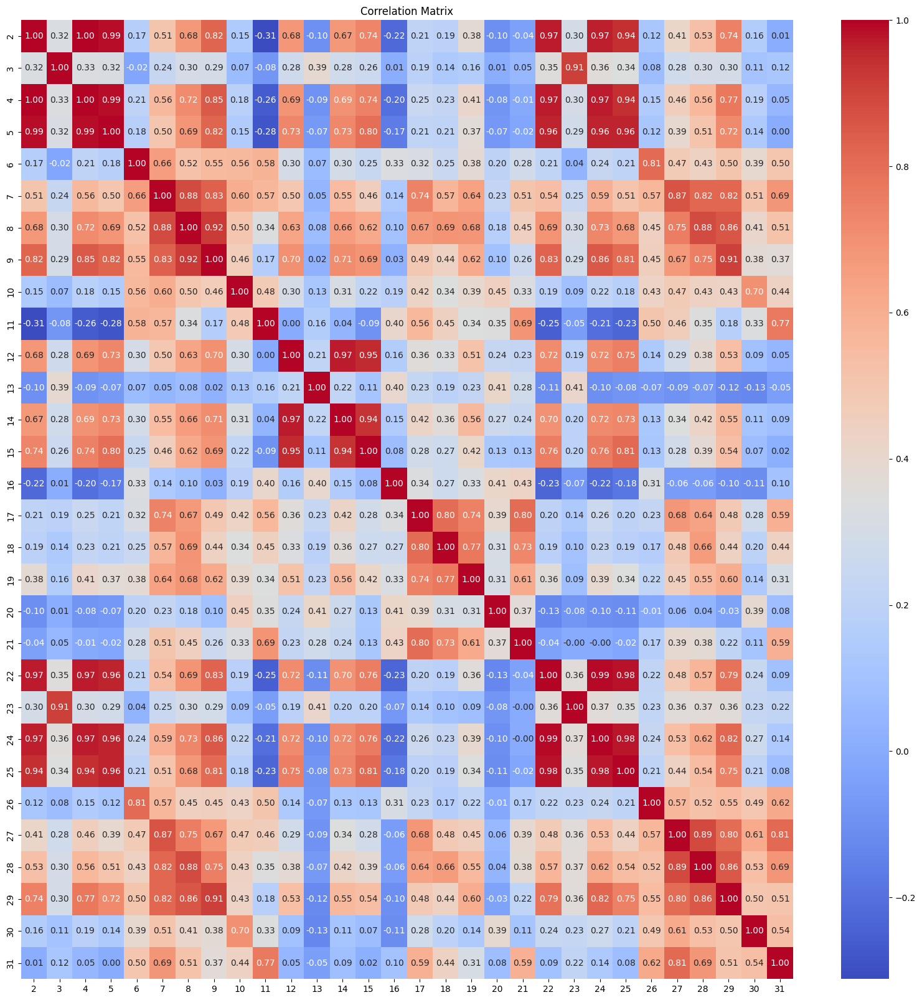

In [ ]:
# features correlation matrix

correlation_matrix = breast_df.drop(columns=[0, 1]).corr()
plt.figure(figsize=(20,20))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')
plt.show()

In [ ]:
# features pairplot

g = sns.pairplot(breast_df.drop(columns=[0]), hue=1)
g.fig.suptitle('Pairplot', y=1.02, fontsize=100)
plt.show()

In [ ]:
# train-test split 70/30

x = breast_df.drop(columns=[0, 1]) # Drop columns by integer index
y = breast_df[1]

X_train, X_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=0, stratify=y)

In [ ]:
# standard scaler and logistic regression pipeline

logistic_model = make_pipeline(StandardScaler(),
                             LogisticRegression(solver='newton-cg', random_state=0)).fit(X_train, y_train)

In [ ]:
# train and test accuracy

print(f"training accuracy = {logistic_model.score(X_train, y_train)}")
print(f"testing accuracy = {logistic_model.score(X_test, y_test)}")

training accuracy = 0.9949748743718593
testing accuracy = 0.9532163742690059


In [ ]:
print(f"Intercept: ", logistic_model[1].intercept_)
print(f"Coefficients: ", logistic_model[1].coef_)

Intercept:  [-0.03897]
Coefficients:  [[ 0.54970312  0.55437793  0.51862451  0.53251725  0.46615143 -0.05722725
   0.64581017  0.94635    -0.24195979  0.09618016  1.25480438  0.12384949
   0.89069006  0.78427744  0.33807794 -0.92450612 -0.08153546  0.32473245
  -0.38943096 -0.67271887  1.02884944  0.67489286  0.88967199  0.87911759
   0.81994441  0.10425152  0.73464166  0.79366989  0.94066565  0.46186065]]


In [ ]:
np.sort(abs(logistic_model[1].coef_[0]))[::-1]

array([1.25480438, 1.02884944, 0.94635   , 0.94066565, 0.92450612,
       0.89069006, 0.88967199, 0.87911759, 0.81994441, 0.79366989,
       0.78427744, 0.73464166, 0.67489286, 0.67271887, 0.64581017,
       0.55437793, 0.54970312, 0.53251725, 0.51862451, 0.46615143,
       0.46186065, 0.38943096, 0.33807794, 0.32473245, 0.24195979,
       0.12384949, 0.10425152, 0.09618016, 0.08153546, 0.05722725])

In [ ]:
# top 10 features

feat_coef = pd.DataFrame({'Feature': x.columns, 'Coefficient': logistic_model[1].coef_[0]})
feat_coef['Coefficient'] = feat_coef['Coefficient'].apply(abs)
feat_coef_sorted = feat_coef.sort_values(by='Coefficient', ascending=False)

feat_coef_sorted.head(10)

,Feature,Coefficient
10,12,1.254804
20,22,1.028849
7,9,0.946350
28,30,0.940666
15,17,0.924506
12,14,0.890690
22,24,0.889672
23,25,0.879118
24,26,0.819944
27,29,0.793670


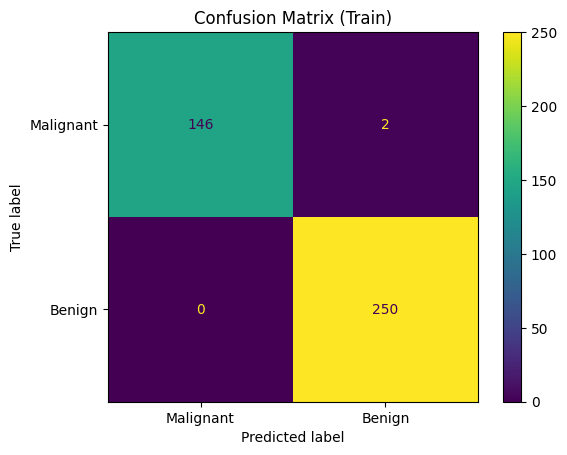

In [ ]:
# training confusion matrix

ypred_train = logistic_model.predict(X_train)

cfm_train = confusion_matrix(y_train, ypred_train, labels=['M','B'])
cm_display = ConfusionMatrixDisplay(confusion_matrix = cfm_train, display_labels = ["Malignant","Benign"])
cm_display.plot()
plt.title('Confusion Matrix (Train)')
plt.show()

In [ ]:
# training per class metrics

print(classification_report(y_train, ypred_train))

              precision    recall  f1-score   support

           B       0.99      1.00      1.00       250
           M       1.00      0.99      0.99       148

    accuracy                           0.99       398
   macro avg       1.00      0.99      0.99       398
weighted avg       1.00      0.99      0.99       398



In [ ]:
# training aggregate metrics

tp = cfm_train[0][0]
fn = cfm_train[0][1]
fp = cfm_train[1][0]
tn = cfm_train[1][1]

false_alarm_rate = fp/(fp + tn)
print(f"False Alarm Rate: {false_alarm_rate}")

precision = tp/(tp + fp)
print(f"Precision: {precision}")

recall = tp/(tp + fn)
print(f"Recall: {recall}")

f1 = 2 * (precision * recall) / (precision + recall)
print(f"F1 Score: {f1}")

False Alarm Rate: 0.0
Precision: 1.0
Recall: 0.9864864864864865
F1 Score: 0.9931972789115647


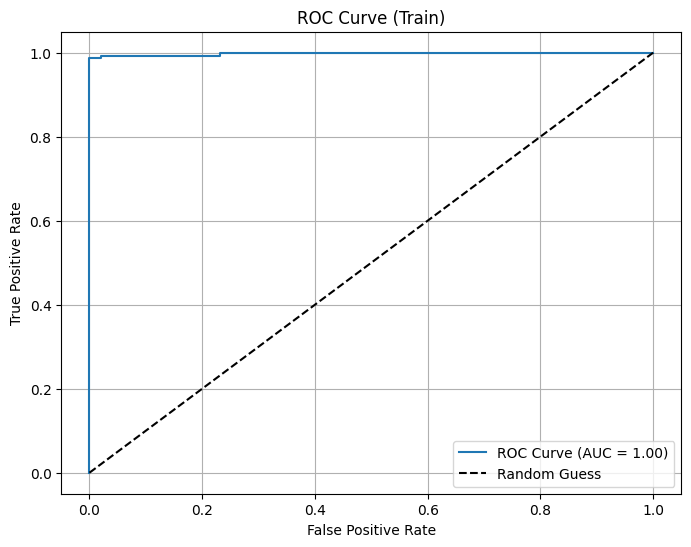

AUC Score: 0.9983


In [ ]:
# training ROC-AUC curve

y_prob_train = logistic_model.predict_proba(X_train)[:, 1]
fpr, tpr, thresholds = roc_curve(y_train, y_prob_train, pos_label='M')
auc_score = roc_auc_score(y_train, y_prob_train)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {auc_score:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess') # Diagonal line
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve (Train)')
plt.legend()
plt.grid()
plt.show()

print(f"AUC Score: {round(auc_score, 4)}")

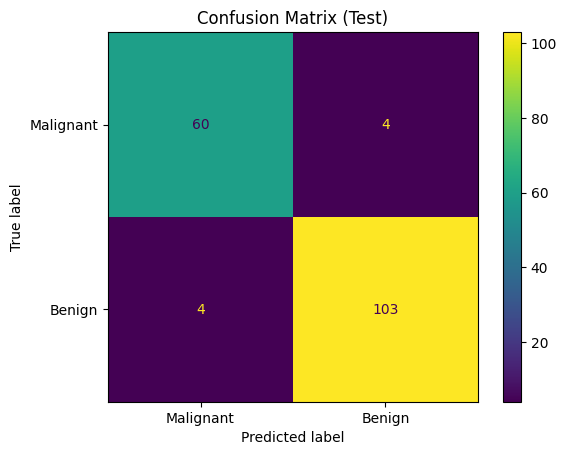

In [ ]:
# testing confusion matrix

ypred_test = logistic_model.predict(X_test)

cfm_test = confusion_matrix(y_test, ypred_test, labels=['M','B'])
cm_display = ConfusionMatrixDisplay(confusion_matrix = cfm_test, display_labels = ["Malignant","Benign"])
cm_display.plot()
plt.title('Confusion Matrix (Test)')
plt.show()

In [ ]:
# testing per class metrics

print(classification_report(y_test, ypred_test))

              precision    recall  f1-score   support

           B       0.96      0.96      0.96       107
           M       0.94      0.94      0.94        64

    accuracy                           0.95       171
   macro avg       0.95      0.95      0.95       171
weighted avg       0.95      0.95      0.95       171



In [ ]:
# testing aggregate metrics

tp = cfm_test[0][0]
fn = cfm_test[0][1]
fp = cfm_test[1][0]
tn = cfm_test[1][1]

false_alarm_rate = fp/(fp + tn)
print(f"False Alarm Rate: {false_alarm_rate}")

precision = tp/(tp + fp)
print(f"Precision: {precision}")

recall = tp/(tp + fn)
print(f"Recall: {recall}")

f1 = 2 * (precision * recall) / (precision + recall)
print(f"F1 Score: {f1}")

False Alarm Rate: 0.037383177570093455
Precision: 0.9375
Recall: 0.9375
F1 Score: 0.9375


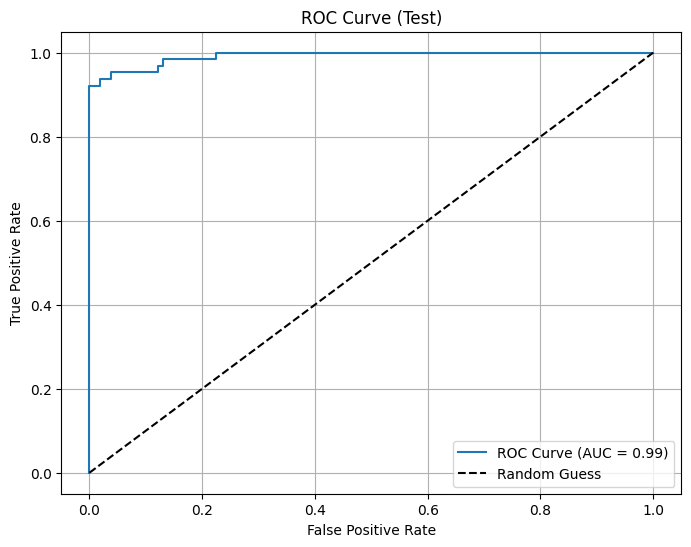

AUC Score: 0.9917


In [ ]:
# testing ROC-AUC curve

y_prob_test = logistic_model.predict_proba(X_test)[:, 1]
fpr, tpr, thresholds = roc_curve(y_test, y_prob_test, pos_label='M')
auc_score = roc_auc_score(y_test, y_prob_test)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {auc_score:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess') # Diagonal line
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve (Test)')
plt.legend()
plt.grid()
plt.show()

print(f"AUC Score: {round(auc_score, 4)}")

## Results

1. `penalty='l2'` (default)

training accuracy = 0.9949748743718593

testing accuracy = 0.9532163742690059

Top 10 coefficients: 1.25480438, 1.02884944, 0.94635, 0.94066565, 0.92450612, 0.89069006, 0.88967199, 0.87911759, 0.81994441, 0.79366989

2. `penalty=None`

training accuracy = 1.0

testing accuracy = 0.9473684210526315

Top 10 coefficients: 23.5801944, 23.03669539, 22.48359262, 21.30249597, 20.44204717, 20.05899363, 17.98246546, 15.97320353, 13.52262256, 13.3474737

## *Insights*

It is interesting to see how removing the default L2 norm or Ridge regularization of the logistic regression function raises the training accuracy to 100% and drastically blows up the coefficient values of the top features, since there is no longer a term on the cost function that penalizes large magnitudes of weights, and making the model low bias-high variance that could potentially overfit the data.